<a href="https://colab.research.google.com/github/Ki-rin/-Segmenting-and-Clustering-Neighborhoods/blob/main/Supervised_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Supervised Learning Examples in Python**

---



Version: 1.0

Prepared by: Matthew Dixon, mdixon7@stuart.iit.edu

Updated and Maintained by: [QuantUniversity](https://www.quantuniversity.com)

For support or additional information, email us at : <professionallearning@cfainstitute.org>

*Copyright 2020 CFA Institute*

## NOTE: This section to be appended after getting info from CFA Institute


---




## How to run this notebook?
This notebook is *view only* and uses Google Colab to run. To **run this Colab notebook**, either:

- **Make a copy to your Google Drive so you can make local changes:** File > Save a copy in Drive...

- **Run in playground mode:** File > Open in playground mode
- **Download the Jupyter notebook, so you can run it on your computer configured with Jupyter:** File > Download .ipynb

![Progress](https://progress-bar.dev/0/?scale=100&title=Progress&width=960&color=babaca&suffix=% "progress")



The purpose of this python notebook is to generate the supervised learning mini-case study results in the CFA Machine learning reading.
## Part 1: ETF Example

In [ ]:
# Import packages you need
from sklearn import tree, svm, metrics
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import graphviz
import matplotlib.pyplot as plt

In [ ]:
# Install additional package
!pip install pandas-profiling==2.8.0
from pandas_profiling import ProfileReport

     |████████████████████████████████| 266kB 6.6MB/s 
     |████████████████████████████████| 61kB 5.9MB/s 
     |████████████████████████████████| 1.1MB 16.3MB/s 
     |████████████████████████████████| 3.2MB 23.4MB/s 
     |████████████████████████████████| 81kB 7.4MB/s 
     |████████████████████████████████| 296kB 35.4MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp37-none-any.whl size=27085 sha256=a931ebfd8a0dcd73873aeb5daa45526b13aa5c226cf0c9f1e2dc894ee314ba65
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for phik: filename=phik-0.11.2-cp37-none-any.whl size=1107413 sha256=50e1dd5649c11cc564b221b03972ea1abfa8c91e7eabccedccd0eaefe253c9d3
  Stored in directory: /root/.cache/pip/wheels/c0/a3/b0/f27b1cfe32ea131a3715169132ff6d85653789e80e966c3bf6
Successfully built htmlmin phik
ERROR: phik 0.11.2 has requirement scipy>=1.5.2, but you'll have scipy 1.4.1 which is incompatible.
  Found existing in

![Progress](https://progress-bar.dev/10/?scale=100&title=Progress&width=960&color=babaca&suffix=% "progress")


### **Step 1: Data pre-processing**
Import the ETF data and preprocess the feature set for classification.

In [ ]:
# Load and format data
etf_features=['investment', 'size', 'net_assets', 'portfolio_stocks', 'portfolio_bonds', 'price_earnings','price_book','price_sales','price_cashflow', 'basic_materials', 'consumer_cyclical', 'financial_services', 'real_estate', 'consumer_defensive', 'healthcare', 'utilities', 'communication_services','energy','industrials', 'technology', 'fund_return_1month']
etf=pd.read_csv('https://cfa-dataset.s3-us-west-2.amazonaws.com/supervised-learning/ETFs_raw.csv', usecols=etf_features)
etf.loc[etf.portfolio_stocks==0, 'portfolio_stocks']=100 - etf.loc[etf.portfolio_stocks==0, 'portfolio_bonds']

In [ ]:
# Subset data
sectors=['basic_materials', 'consumer_cyclical', 'financial_services', 'real_estate', 'consumer_defensive', 'healthcare', 'utilities', 'communication_services','energy','industrials', 'technology']
idx=np.where(np.sum(etf[sectors], axis=1)>0)
etf_clean=etf.loc[idx]
etf_clean.head()

,net_assets,investment,size,portfolio_stocks,portfolio_bonds,price_earnings,price_book,price_sales,price_cashflow,basic_materials,consumer_cyclical,financial_services,real_estate,consumer_defensive,healthcare,utilities,communication_services,energy,industrials,technology,fund_return_1month
0,4.010000e+12,Blend,Large,100.00,0.0,12.92,1.18,0.81,5.41,7.81,17.26,11.73,3.19,9.44,7.05,1.96,4.95,1.70,20.29,14.61,1.22
1,8.430000e+12,Blend,Large,99.99,0.0,12.92,1.18,0.81,5.41,7.81,17.26,11.73,3.19,9.43,7.06,1.96,4.95,1.70,20.29,14.62,1.30
2,3.730000e+12,Blend,Large,99.08,0.0,12.92,1.18,0.81,5.44,7.74,17.33,11.57,3.22,9.53,7.07,1.99,4.98,1.70,20.23,14.62,1.31
3,4.450000e+09,Value,Large,18.57,0.0,12.09,1.01,0.56,3.86,6.38,13.36,14.15,0.00,10.13,11.00,3.68,10.08,8.52,18.17,4.53,-0.39
4,1.920000e+09,Blend,Large,100.00,0.0,11.34,1.12,1.07,4.06,2.41,14.25,16.26,1.74,7.93,4.55,0.00,15.52,2.00,16.26,19.06,0.27


In [ ]:
# Label data based on one standard deviation of the mean
mean = np.mean(etf_clean['fund_return_1month'])
sigma = np.std(etf_clean['fund_return_1month'])
etf_clean['label']=0
etf_clean.loc[etf_clean['fund_return_1month']>=(mean+sigma), 'label']=1
etf_clean.loc[etf_clean['fund_return_1month']<=(mean-sigma), 'label']=-1
etf_clean.sample(5)

,net_assets,investment,size,portfolio_stocks,portfolio_bonds,price_earnings,price_book,price_sales,price_cashflow,basic_materials,consumer_cyclical,financial_services,real_estate,consumer_defensive,healthcare,utilities,communication_services,energy,industrials,technology,fund_return_1month,label
337,300380000.0,Value,Large,99.98,0.0,11.85,1.70,1.11,6.56,1.52,7.57,33.16,0.00,6.07,22.81,3.01,0.00,2.97,6.08,16.80,-1.50,0
1237,60470000.0,Blend,Large,99.63,0.0,15.61,2.70,1.96,12.98,4.99,7.79,0.00,0.08,10.19,32.31,2.44,0.00,19.58,8.08,14.53,1.67,0
1965,3210000.0,Blend,Large,100.00,0.0,16.52,2.59,1.79,8.14,3.12,15.13,16.09,3.17,9.86,18.38,4.23,4.52,6.89,11.73,6.88,1.15,0
646,698780000.0,Blend,Large,99.11,0.0,13.70,1.46,1.07,6.55,8.19,11.25,19.08,3.82,11.92,10.65,3.84,4.10,6.19,13.29,7.67,0.91,0
667,28700000.0,Blend,Large,99.26,0.0,16.36,2.12,1.47,10.99,3.29,7.70,17.16,3.50,19.82,14.86,9.49,8.81,3.84,9.69,1.83,2.13,0


In [ ]:
# Optional way to do encode
# etf_clean = etf_clean.fillna({'size':'Medium','investment':'Growth'})
# etf_clean['size'] = etf_clean['size'].astype('category')
# etf_clean['cat_size'] = etf_clean['size'].cat.codes
# print(etf_clean['cat_size'].unique())

In [ ]:
# Encoding categorical values
print(etf_clean['size'].unique())
etf_clean['cat_size'] =0
etf_clean.loc[etf_clean['size']=='Large','cat_size']=1
etf_clean.loc[etf_clean['size']=='Medium','cat_size']=0
etf_clean.loc[etf_clean['size']=='Small','cat_size']=-1
print(etf_clean['cat_size'].unique())

['Large' 'Medium' 'Small' nan]
[ 1  0 -1]


In [ ]:
# Encoding categorical values
print(etf_clean['investment'].unique())
etf_clean['cat_investment']=0
etf_clean.loc[etf_clean['investment']=='Blend','cat_investment']=1
etf_clean.loc[etf_clean['investment']=='Growth','cat_investment']=0
etf_clean.loc[etf_clean['investment']=='Value','cat_investment']=-1
print(etf_clean['cat_investment'].unique())

['Blend' 'Value' 'Growth' nan]
[ 1 -1  0]


In [ ]:
# Define columns
etf_training_features = ['cat_investment', 'cat_size', 'net_assets', 'portfolio_stocks', 'portfolio_bonds', 'price_earnings','price_book','price_sales','price_cashflow', 'basic_materials', 'consumer_cyclical', 'financial_services', 'real_estate', 'consumer_defensive', 'healthcare', 'utilities', 'communication_services','energy','industrials', 'technology']
etf_training_features_w_label = etf_training_features  + ['label']

In [ ]:
etf_clean

,net_assets,investment,size,portfolio_stocks,portfolio_bonds,price_earnings,price_book,price_sales,price_cashflow,basic_materials,consumer_cyclical,financial_services,real_estate,consumer_defensive,healthcare,utilities,communication_services,energy,industrials,technology,fund_return_1month,label,cat_size,cat_investment
0,4.010000e+12,Blend,Large,100.00,0.0,12.92,1.18,0.81,5.41,7.81,17.26,11.73,3.19,9.44,7.05,1.96,4.95,1.70,20.29,14.61,1.22,0,1,1
1,8.430000e+12,Blend,Large,99.99,0.0,12.92,1.18,0.81,5.41,7.81,17.26,11.73,3.19,9.43,7.06,1.96,4.95,1.70,20.29,14.62,1.30,0,1,1
2,3.730000e+12,Blend,Large,99.08,0.0,12.92,1.18,0.81,5.44,7.74,17.33,11.57,3.22,9.53,7.07,1.99,4.98,1.70,20.23,14.62,1.31,0,1,1
3,4.450000e+09,Value,Large,18.57,0.0,12.09,1.01,0.56,3.86,6.38,13.36,14.15,0.00,10.13,11.00,3.68,10.08,8.52,18.17,4.53,-0.39,0,1,-1
4,1.920000e+09,Blend,Large,100.00,0.0,11.34,1.12,1.07,4.06,2.41,14.25,16.26,1.74,7.93,4.55,0.00,15.52,2.00,16.26,19.06,0.27,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2342,4.370000e+06,Blend,Large,92.59,0.0,17.35,3.05,2.30,9.84,11.42,11.10,19.46,1.12,12.32,8.88,5.41,7.65,1.43,12.05,9.17,0.91,0,1,1
2343,1.909000e+07,Value,Medium,100.00,0.0,12.90,1.44,0.98,5.15,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,100.00,0.00,0.00,1.15,0,0,-1
2344,4.241000e+07,Value,Small,98.85,0.0,12.89,1.19,0.32,7.03,21.48,0.00,0.00,0.00,0.00,0.00,16.54,0.00,42.88,19.10,0.00,2.29,0,-1,-1
2346,2.164600e+08,Value,Large,20.43,60.7,14.30,1.77,1.19,5.78,1.97,4.12,6.91,3.68,3.10,5.22,7.62,2.15,50.51,8.17,6.54,0.74,0,1,-1


In [ ]:
# Remove records with empty value
etf_clean_=etf_clean[etf_training_features_w_label].dropna()
# Snapshot the cleaned data
etf_clean_[etf_training_features_w_label].to_csv('ETF_clean.csv')

![Progress](https://progress-bar.dev/20/?scale=100&title=Progress&width=960&color=babaca&suffix=% "progress")

### **Step 2: Explore the clean dataset**

In [ ]:
etf_clean_.describe()

,cat_investment,cat_size,net_assets,portfolio_stocks,portfolio_bonds,price_earnings,price_book,price_sales,price_cashflow,basic_materials,consumer_cyclical,financial_services,real_estate,consumer_defensive,healthcare,utilities,communication_services,energy,industrials,technology,label
count,1594.000000,1594.000000,1.594000e+03,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000,1594.000000
mean,0.139272,0.575282,2.910526e+10,92.909348,2.306769,15.174285,2.071104,1.606023,7.648921,7.777610,11.448407,15.723795,7.209831,7.391493,9.493124,5.013105,3.292447,7.290427,11.426173,13.933557,-0.020075
std,0.866870,0.655972,3.525527e+11,19.616247,11.983481,5.408691,1.111340,1.187685,3.776774,14.968599,12.850317,18.832106,17.874967,11.302261,16.823674,11.892267,5.009641,16.165923,13.739266,17.314139,0.444932
min,-1.000000,-1.000000,6.937500e+05,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000
25%,-1.000000,0.000000,3.028500e+07,98.782500,0.000000,12.242500,1.380000,0.930000,5.220000,0.670000,2.697500,0.740000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.007500,1.142500,0.000000
50%,0.000000,1.000000,1.686600e+08,99.640000,0.000000,14.475000,1.780000,1.260000,7.030000,4.380000,10.955000,13.770000,2.450000,5.885000,6.065000,2.375000,2.160000,3.350000,9.960000,10.190000,0.000000
75%,1.000000,1.000000,9.099550e+08,99.877500,0.000000,17.050000,2.457500,1.920000,9.157500,8.367500,14.662500,19.957500,6.122500,9.732500,11.877500,4.712500,4.537500,6.790000,14.707500,18.307500,0.000000
max,1.000000,1.000000,8.430000e+12,100.000000,99.190000,49.270000,10.770000,10.150000,41.980000,100.000000,99.390000,100.000000,100.000000,100.000000,100.000000,100.000000,99.370000,100.000000,100.000000,100.000000,1.000000


In [ ]:
profile = ProfileReport(etf_clean_, title="Pandas Profiling Report", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/36 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

![Progress](https://progress-bar.dev/30/?scale=100&title=Progress&width=960&color=babaca&suffix=% "progress")

### **Step 3: Split data to training and testing datasets**

In [ ]:
# Split into random train and test subsets
X = etf_clean_[etf_training_features]
y = etf_clean_['label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

![Progress](https://progress-bar.dev/40/?scale=100&title=Progress&width=960&color=babaca&suffix=% "progress")

### **Step 4: Try out machine learning models**
#### We will try 4 machine learning models:

*   CART
*   SVM
*   KNN
*   Random Forest



### Model 1: CART on ETF data

In [ ]:
# Train the decision tree
clf = tree.DecisionTreeClassifier(max_depth=4)
clf = clf.fit(X_train, y_train)

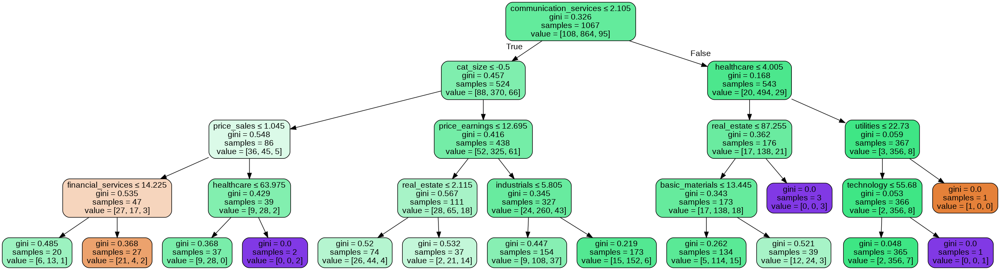

In [ ]:
# Visualize the tree
dot_data = tree.export_graphviz(clf, out_file=None,  
                filled=True, rounded=True,
                special_characters=True, feature_names=etf_training_features)
graph = graphviz.Source(dot_data)
from IPython.display import Image 
Image(graph.pipe(format="png"))

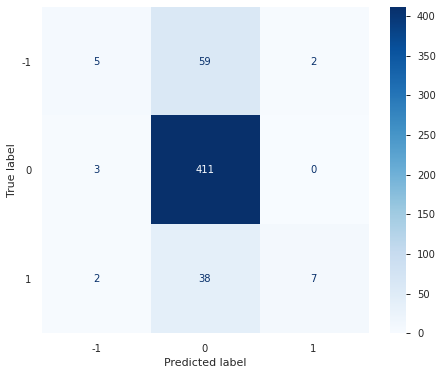

In [ ]:
# Evaluate by Confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
metrics.plot_confusion_matrix(clf, X_test, y_test, values_format='d', cmap='Blues',ax=ax)
plt.show()

In [ ]:
# Evaluate by scores
y_pred_CART=clf.predict(X_test)
accuracy_CART = metrics.accuracy_score(y_test, y_pred_CART)
f1_CART = metrics.f1_score(y_test, y_pred_CART, average='weighted')
df_compare_ETF = pd.DataFrame(columns=['Accuracy','F1'])
df_compare_ETF.loc['CART']={'Accuracy':accuracy_CART,'F1':f1_CART}
df_compare_ETF

,Accuracy,F1
CART,0.802657,0.73915


![Progress](https://progress-bar.dev/55/?scale=100&title=Progress&width=960&color=babaca&suffix=% "progress")

### Model 2: SVM on ETF Data

In [ ]:
# Train the SVC
clf = svm.SVC(gamma='scale')
clf.fit(X_train, y_train) 

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

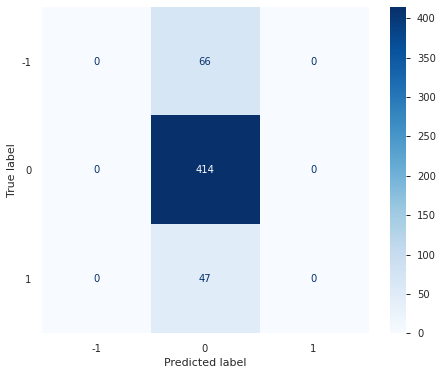

In [ ]:
# Evaluate the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
metrics.plot_confusion_matrix(clf, X_test, y_test, values_format='d', cmap='Blues', ax=ax)
plt.show()

In [ ]:
# Evaluate by scores
y_pred_svm=clf.predict(X_test)
accuracy_svm = metrics.accuracy_score(y_test, y_pred_svm)
f1_svm = metrics.f1_score(y_test, y_pred_svm, average='weighted')
df_compare_ETF.loc['SVM']={'Accuracy':accuracy_svm,'F1':f1_svm}
df_compare_ETF

,Accuracy,F1
CART,0.802657,0.739150
SVM,0.785579,0.691243


![Progress](https://progress-bar.dev/70/?scale=100&title=Progress&width=960&color=babaca&suffix=% "progress")

### Model 3: KNN on ETF data

In [ ]:
# Train the KNN
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(X_train, y_train) 

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=3, p=2,
                     weights='uniform')

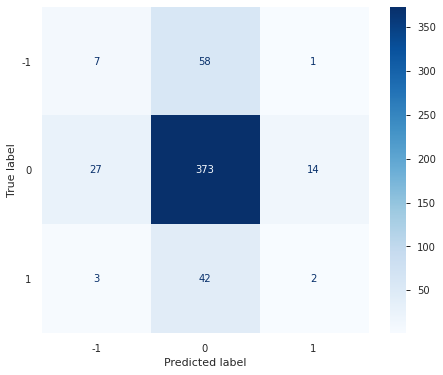

In [ ]:
# Evaluate by confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
metrics.plot_confusion_matrix(neigh, X_test, y_test, values_format='d', cmap='Blues', ax=ax)
plt.show()

In [ ]:
# Evaluate by scores
y_pred_knn=neigh.predict(X_test)
accuracy_knn = metrics.accuracy_score(y_test, y_pred_knn)
f1_knn = metrics.f1_score(y_test, y_pred_knn, average='weighted')
df_compare_ETF.loc['KNN']={'Accuracy':accuracy_knn,'F1':f1_knn}
df_compare_ETF

,Accuracy,F1
CART,0.802657,0.739150
SVM,0.785579,0.691243
KNN,0.724858,0.683297


![Progress](https://progress-bar.dev/85/?scale=100&title=Progress&width=960&color=babaca&suffix=% "progress")

### Model 4: RandomForest on ETF Data

In [ ]:
# Train the RandomForest model
clf = RandomForestClassifier(n_estimators=100, max_depth=20,
                             random_state=0)
clf.fit(X_train, y_train) 

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=20, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=0, verbose=0,
                       warm_start=False)

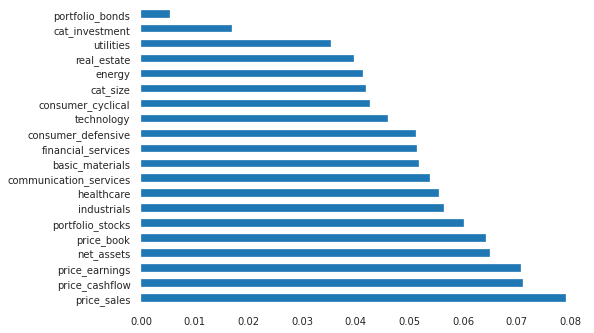

In [ ]:
# Explore feature importances
bar_data = pd.Series(clf.feature_importances_, index=X_train.columns)
bar_data.nlargest(20).plot(kind='barh')
plt.show()

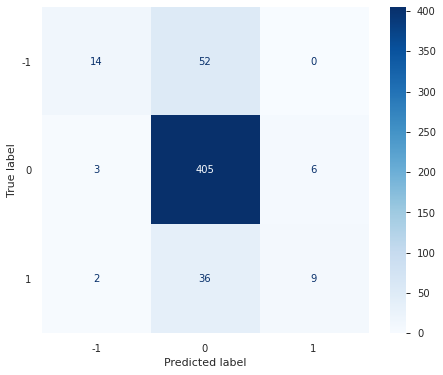

In [ ]:
# Evaluate by confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
metrics.plot_confusion_matrix(clf, X_test, y_test, values_format='d', cmap='Blues', ax=ax)
plt.show()

In [ ]:
# Evaluate by scores
y_pred_rf=clf.predict(X_test)
accuracy_rf = metrics.accuracy_score(y_test, y_pred_rf)
f1_rf = metrics.f1_score(y_test, y_pred_rf, average='weighted')
df_compare_ETF.loc['RandomForest'] = {'Accuracy':accuracy_rf,'F1':f1_rf}
df_compare_ETF

,Accuracy,F1
CART,0.802657,0.739150
SVM,0.785579,0.691243
KNN,0.724858,0.683297
RandomForest,0.812144,0.768711


As you can see the Random forest model gives the best accuracy. 
Can you improve upon this? Things to try/think about:


*   Modify the hyper parameters for each model and try again. Does that change the accuracy?
*   As you can note, the class with label 0 is the dominant class. How can you handle imbalance in this problem?
*   As a portfolio manager, how would you interpret these results?   






![progress](https://progress-bar.dev/100/?scale=100&title=ETF&width=960&color=babaca&suffix=% "progress")

### **Exercise: We will repeat the above example for a different Mutual funds dataset. Try to work on this problem independently. You can visit the solution notebook after you try it.**
Start with a new notebook and work this mutual funds [dataset](https://cfa-dataset.s3-us-west-2.amazonaws.com/supervised-learning/Mutual+Funds_raw.csv)



## Reference:
### CFA Refresher Reading
1.   [Machine Learning](https://www.cfainstitute.org/en/membership/professional-development/refresher-readings/machine-learning)

> Summary:

> * Dive deeper into machine learning concepts with a member-only course, eligible for up to 8.75 PL credits.


---

![progress](https://progress-bar.dev/100/?scale=100&title=END!&width=980&color=babaca&suffix=% "progress")